Import necessary libraries.

In [1]:
import os
import sys
import time
import re
from collections import namedtuple

import numpy as np
import torch
from torch.optim import Adam
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from torchvision import datasets
from torchvision import transforms
from torchvision import models
from PIL import Image
import matplotlib.pyplot as plt

Define utility functions. 

In [2]:
def transform_net_load_image(filename, size=None, scale=None):
  """
  Load the image by the given filename. The image would be resized if size or scale is set. 

  :param size: New size of the image
  :param scale: The scale ratio to resize the image
  :return: The resized image
  """
  image = Image.open(filename).convert('RGB')
  target_size = image.size
  if size is not None:
    target_size = (size, size)
  elif scale is not None:
    target_size = (int(image.size[0] / scale), int(image.size[1] / scale))

  return image.resize(target_size, Image.ANTIALIAS)

def transform_net_imshow(image, title=None):
  # print(f'The size of the given image: {image.size()}')
  with torch.no_grad():
    image = image.cpu().clone().clamp(0, 255).numpy()
    image = image.transpose(1, 2, 0).astype('uint8')
    image = Image.fromarray(image)

  fig = plt.figure(figsize=(5,5))
  plt.imshow(image)
  if title is not None:
    plt.title(title)
  plt.xticks([])
  plt.yticks([])
  plt.show()

def gram_matrix(y):
  (b, ch, h, w) = y.size()
  features = y.view(b, ch, w * h)
  features_t = features.transpose(1, 2)
  gram = features.bmm(features_t) / (ch * h * w)
  return gram

def normalize_batch(batch):
  # normalize using imagenet mean and std
  mean = batch.new_tensor([0.485, 0.456, 0.406]).view(-1, 1, 1)
  std = batch.new_tensor([0.229, 0.224, 0.225]).view(-1, 1, 1)
  batch = batch.div_(255.0)
  return (batch - mean) / std


class COCODataset(Dataset):
  def __init__(self, image_directory, transform=None):
    self.image_names = []
    self.image_directory = image_directory
    self.transform = transform
    for image_name in os.listdir(image_directory):
      self.image_names.append(image_name)

  def __len__(self):
    return len(self.image_names)

  def __getitem__(self, index):
    image_name = os.path.join(self.image_directory, self.image_names[index])
    image = transform_net_load_image(image_name)

    if self.transform:
      image = self.transform(image)

    return image, 0
  

Define VGG model.

In [3]:
class Vgg16(torch.nn.Module):
  def __init__(self, requires_grad=False):
    super(Vgg16, self).__init__()
    vgg_pretrained_features = models.vgg16(pretrained=True).features
    self.slice1 = torch.nn.Sequential()
    self.slice2 = torch.nn.Sequential()
    self.slice3 = torch.nn.Sequential()
    self.slice4 = torch.nn.Sequential()
    for x in range(4):
      self.slice1.add_module(str(x), vgg_pretrained_features[x])
    for x in range(4, 9):
      self.slice2.add_module(str(x), vgg_pretrained_features[x])
    for x in range(9, 16):
      self.slice3.add_module(str(x), vgg_pretrained_features[x])
    for x in range(16, 23):
      self.slice4.add_module(str(x), vgg_pretrained_features[x])
    
    if not requires_grad:
      for param in self.parameters():
        param.requires_grad = False

  def forward(self, x):
    x = self.slice1(x)
    result_relu1_2 = x
    x = self.slice2(x)
    result_relu2_2 = x
    x = self.slice3(x)
    result_relu3_3 = x
    x = self.slice4(x)
    result_relu4_3 = x
    vgg_outputs = namedtuple("vgg_outputs", ['relu1_2', 'relu2_2', 'relu3_3', 'relu4_3'])
    return vgg_outputs(result_relu1_2, result_relu2_2, result_relu3_3, result_relu4_3)



Define Transformer Net.

In [4]:
class ConvLayer(torch.nn.Module):
  def __init__(self, in_channels, out_channels, kernel_size, stride):
    super(ConvLayer, self).__init__()
    reflection_padding = kernel_size // 2
    self.reflection_pad = torch.nn.ReflectionPad2d(reflection_padding)
    self.conv2d = torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride)

  def forward(self, x):
    x = self.reflection_pad(x)
    x = self.conv2d(x)
    return x


class ResidualBlock(torch.nn.Module):
  def __init__(self, channels):
    super(ResidualBlock, self).__init__()
    self.conv1 = ConvLayer(channels, channels, kernel_size=3, stride=1)
    self.in1 = torch.nn.InstanceNorm2d(channels, affine=True)
    self.conv2 = ConvLayer(channels, channels, kernel_size=3, stride=1)
    self.in2 = torch.nn.InstanceNorm2d(channels, affine=True)
    self.relu = torch.nn.ReLU()

  def forward(self, x):
    residual = x
    x = self.relu(self.in1(self.conv1(x)))
    x = self.in2(self.conv2(x))
    x = x + residual
    return x


class UpsampleConvLayer(torch.nn.Module):
  def __init__(self, in_channels, out_channels, kernel_size, stride, upsample=None):
    super(UpsampleConvLayer, self).__init__()
    self.upsample = upsample
    reflection_padding = kernel_size // 2
    self.reflection_pad = torch.nn.ReflectionPad2d(reflection_padding)
    self.conv2d = torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride)

  def forward(self, x):
    if self.upsample:
      x = torch.nn.functional.interpolate(x, mode='nearest', scale_factor=self.upsample)
    x = self.reflection_pad(x)
    return self.conv2d(x)


class TransformerNet(torch.nn.Module):
  def __init__(self):
    super(TransformerNet, self).__init__()
    self.conv1 = ConvLayer(3, 32, kernel_size=9, stride=1)
    self.in1 = torch.nn.InstanceNorm2d(32, affine=True)
    self.conv2 = ConvLayer(32, 64, kernel_size=3, stride=2)
    self.in2 = torch.nn.InstanceNorm2d(64, affine=True)
    self.conv3 = ConvLayer(64, 128, kernel_size=3, stride=2)
    self.in3 = torch.nn.InstanceNorm2d(128, affine=True)
    # residual layers
    self.res1 = ResidualBlock(128)
    self.res2 = ResidualBlock(128)
    self.res3 = ResidualBlock(128)
    self.res4 = ResidualBlock(128)
    self.res5 = ResidualBlock(128)
    # upsampling layers
    self.deconv1 = UpsampleConvLayer(128, 64, kernel_size=3, stride=1, upsample=2)
    self.in4 = torch.nn.InstanceNorm2d(64, affine=True)
    self.deconv2 = UpsampleConvLayer(64, 32, kernel_size=3, stride=1, upsample=2)
    self.in5 = torch.nn.InstanceNorm2d(32, affine=True)
    self.deconv3 = ConvLayer(32, 3, kernel_size=9, stride=1)

    self.relu = torch.nn.ReLU()

  def forward(self, x):
    x = self.relu(self.in1(self.conv1(x)))
    x = self.relu(self.in2(self.conv2(x)))
    x = self.relu(self.in3(self.conv3(x)))
    x = self.res1(x)
    x = self.res2(x)
    x = self.res3(x)
    x = self.res4(x)
    x = self.res5(x)
    x = self.relu(self.in4(self.deconv1(x)))
    x = self.relu(self.in5(self.deconv2(x)))
    return self.deconv3(x)

Prepare the COCO dataset.

In [5]:
!wget http://images.cocodataset.org/zips/train2017.zip

--2022-04-29 17:06:51--  http://images.cocodataset.org/zips/train2017.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 52.216.207.139
Connecting to images.cocodataset.org (images.cocodataset.org)|52.216.207.139|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 19336861798 (18G) [application/zip]
Saving to: ‘train2017.zip’

train2017.zip       100%[===================>]  18.01G  55.1MB/s    in 4m 35s  

2022-04-29 17:11:26 (67.0 MB/s) - ‘train2017.zip’ saved [19336861798/19336861798]



In [6]:
!unzip train2017.zip

Streaming output truncated to the last 5000 lines.
 extracting: train2017/000000259556.jpg  
 extracting: train2017/000000381931.jpg  
 extracting: train2017/000000569592.jpg  
 extracting: train2017/000000229396.jpg  
 extracting: train2017/000000488990.jpg  
 extracting: train2017/000000348684.jpg  
 extracting: train2017/000000234031.jpg  
 extracting: train2017/000000563584.jpg  
 extracting: train2017/000000276069.jpg  
 extracting: train2017/000000401194.jpg  
 extracting: train2017/000000502089.jpg  
 extracting: train2017/000000192183.jpg  
 extracting: train2017/000000425127.jpg  
 extracting: train2017/000000126766.jpg  
 extracting: train2017/000000324161.jpg  
 extracting: train2017/000000452746.jpg  
 extracting: train2017/000000423782.jpg  
 extracting: train2017/000000546343.jpg  
 extracting: train2017/000000249290.jpg  
 extracting: train2017/000000025529.jpg  
 extracting: train2017/000000316928.jpg  
 extracting: train2017/000000337866.jpg  
 extracting: train2017/00

In [7]:
from google.colab import drive
drive.mount('./drive')

Mounted at ./drive


In [25]:
# set device to gpu or cpu based on availability
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

def train(style_image_path="./rain-princess-cropped.jpeg", 
          dataset_path="./train2017", 
          image_size=256, 
          epoch_size=2,
          batch_size=4, 
          learning_rate=1e-3,
          content_weight=1e5,
          style_weight=1e10
          ):
  # load the training data
  data_transform = transforms.Compose([
                                     transforms.Resize(image_size),
                                     transforms.CenterCrop(image_size),
                                     transforms.ToTensor(),
                                     transforms.Lambda(lambda x: x.mul(255))
  ])
  train_dataset = COCODataset(dataset_path, data_transform)
  train_loader = DataLoader(train_dataset, batch_size=batch_size)

  # initialize the transformer net
  transformer_net = TransformerNet().to(device)
  optimizer = Adam(transformer_net.parameters(), learning_rate)
  mse_loss = torch.nn.MSELoss()

  vgg = Vgg16().to(device)
  style_transform = transforms.Compose([
                                        transforms.ToTensor(),
                                        transforms.Lambda(lambda x: x.mul(255))
  ])
  style_image = transform_net_load_image(style_image_path, size=image_size)
  style_image = style_transform(style_image)
  style_image = style_image.repeat(batch_size, 1, 1, 1).to(device)

  # extract the features from the style image
  style_image_vgg_output = vgg(normalize_batch(style_image))
  style_features = [gram_matrix(y) for y in style_image_vgg_output]

  # statistics
  content_loss_list = []
  style_loss_list = []
  image_count_index = []
  total_image_count = 0

  for epoch in range(epoch_size):
    transformer_net.train()
    average_content_loss = 0.
    average_style_loss = 0.
    image_count = 0

    for batch_id, (x, _) in enumerate(train_loader):
      batch_size = len(x)
      image_count += batch_size
      total_image_count += batch_size
      optimizer.zero_grad()

      x = x.to(device)
      original_image = x.cpu().clone()
      output_image = transformer_net(x)
      original_output_image = output_image.cpu().clone()

      output_image = normalize_batch(output_image)
      x = normalize_batch(x)

      output_image_vgg_outputs = vgg(output_image)
      features_x = vgg(x)

      # get the content loss
      content_loss = content_weight * mse_loss(output_image_vgg_outputs.relu2_2, features_x.relu2_2)

      # get the style loss
      style_loss = 0.
      for output_image_vgg_output, style_feature in zip(output_image_vgg_outputs, style_features):
        output_image_style_feature = gram_matrix(output_image_vgg_output)
        style_loss += mse_loss(output_image_style_feature, style_feature[:batch_size, :, :])
      style_loss *= style_weight

      # run the optimization
      total_loss = content_loss + style_loss
      total_loss.backward()
      optimizer.step()

      # calculate the statistic
      average_content_loss += content_loss.item()
      average_style_loss += style_loss.item()

      if (batch_id + 1) % 500 == 0:
        print(f'Epoch {epoch}:\t[{image_count}/{len(train_dataset)}]\taverage content loss: {average_content_loss / (batch_id + 1)}\taverage style loss: {average_style_loss / (batch_id + 1)}\ttotal loss: {(average_content_loss + average_style_loss) / (batch_id + 1)}')
        transform_net_imshow(original_output_image[0], title='output image')
        transform_net_imshow(original_image[0], title='content image')
        content_loss_list.append(content_loss.item())
        style_loss_list.append(style_loss.item())
        image_count_index.append(total_image_count)

    model_name = f'epoch_{epoch}.model'
    model_path = os.path.join('./drive/MyDrive/model', model_name)
    torch.save(transformer_net.state_dict(), model_path)

  plt.plot(image_count_index, content_loss_list)
  plt.plot(image_count_index, style_loss_list)
  plt.legend(['content loss', 'style loss'])
  plt.xlabel('image count')
  print(image_count_index)
  plt.show()



Epoch 0:	[2000/118287]	average content loss: 1422610.81825	average style loss: 3611449.819125	total loss: 5034060.637375


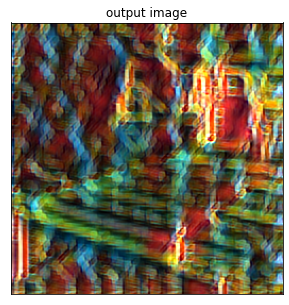

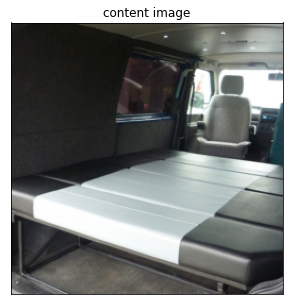

Epoch 0:	[4000/118287]	average content loss: 1416889.17525	average style loss: 2104349.36784375	total loss: 3521238.54309375


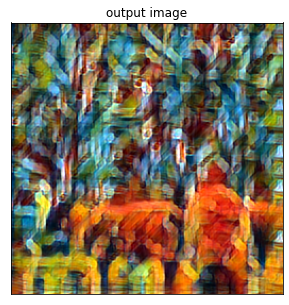

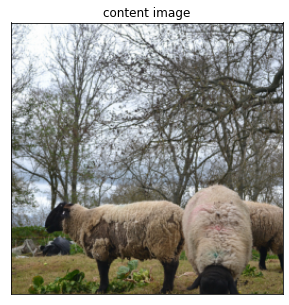

Epoch 0:	[6000/118287]	average content loss: 1382555.0335833333	average style loss: 1561750.2661458333	total loss: 2944305.2997291666


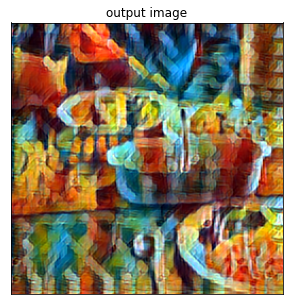

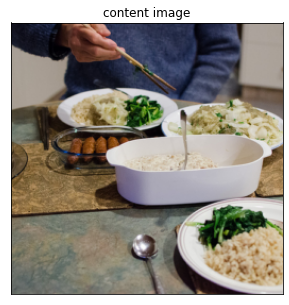

Epoch 0:	[8000/118287]	average content loss: 1346956.622375	average style loss: 1276904.74221875	total loss: 2623861.36459375


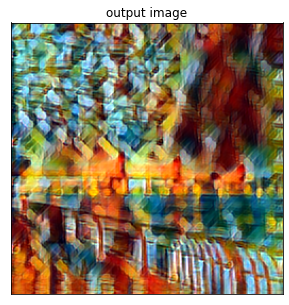

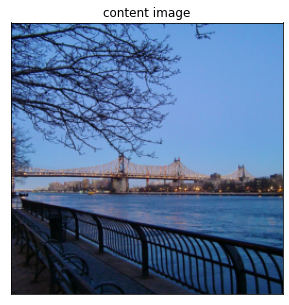

Epoch 0:	[10000/118287]	average content loss: 1316177.68035	average style loss: 1101333.24525	total loss: 2417510.9256


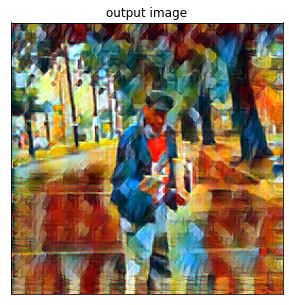

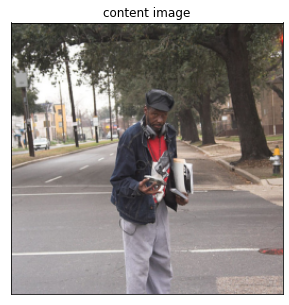

Epoch 0:	[12000/118287]	average content loss: 1288354.2146041666	average style loss: 981428.636375	total loss: 2269782.8509791666


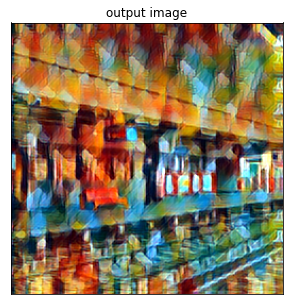

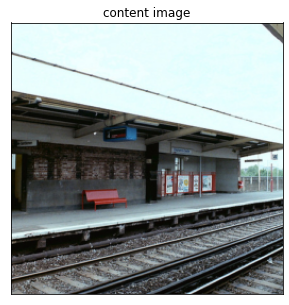

Epoch 0:	[14000/118287]	average content loss: 1263497.557607143	average style loss: 894618.592125	total loss: 2158116.1497321427


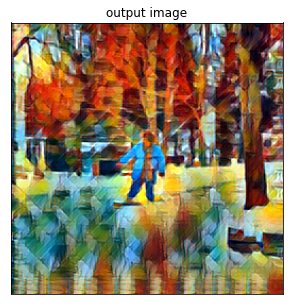

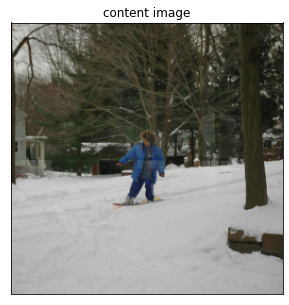

Epoch 0:	[16000/118287]	average content loss: 1241548.355140625	average style loss: 828009.9004375	total loss: 2069558.255578125


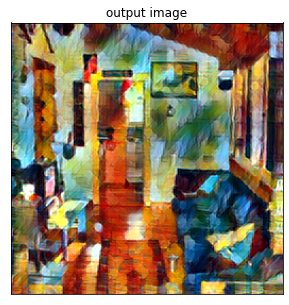

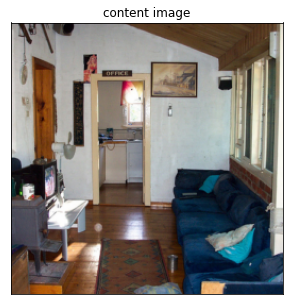

Epoch 0:	[18000/118287]	average content loss: 1221698.6082222222	average style loss: 775751.9784722222	total loss: 1997450.5866944445


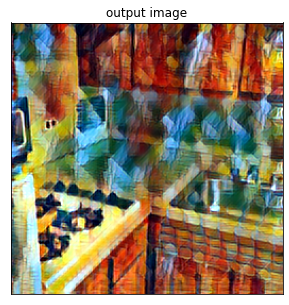

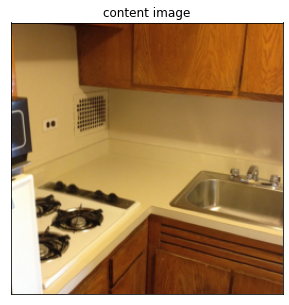

Epoch 0:	[20000/118287]	average content loss: 1204610.7256875	average style loss: 733619.95703125	total loss: 1938230.68271875


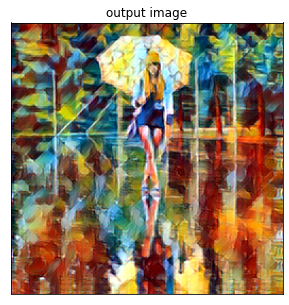

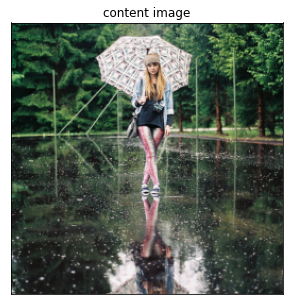

Epoch 0:	[22000/118287]	average content loss: 1188528.112909091	average style loss: 698446.034778409	total loss: 1886974.1476875


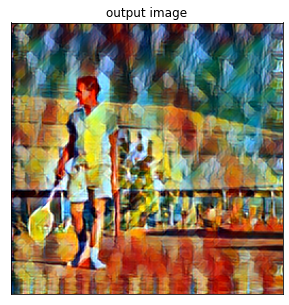

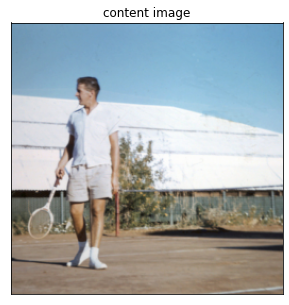

Epoch 0:	[24000/118287]	average content loss: 1174118.7961145833	average style loss: 669176.0429479167	total loss: 1843294.8390625


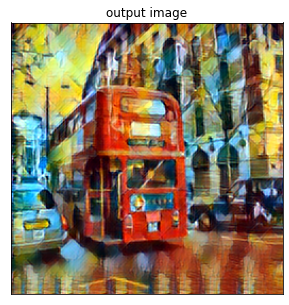

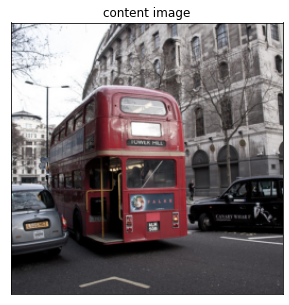

Epoch 0:	[26000/118287]	average content loss: 1161035.1604423076	average style loss: 643944.0046346154	total loss: 1804979.165076923


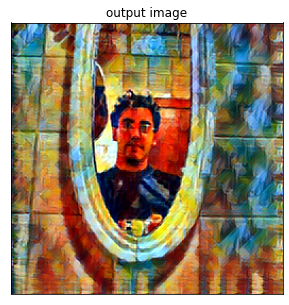

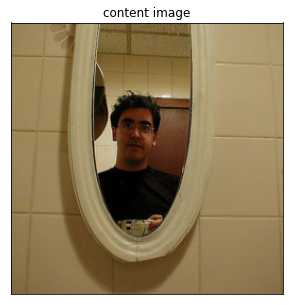

Epoch 0:	[28000/118287]	average content loss: 1148985.4973035713	average style loss: 622123.0796607143	total loss: 1771108.5769642857


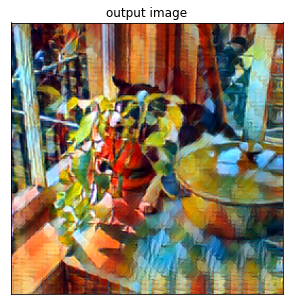

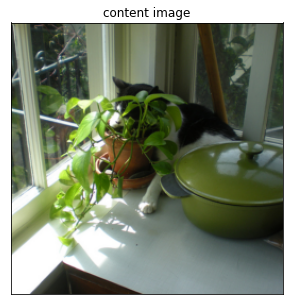

Epoch 0:	[30000/118287]	average content loss: 1137699.252775	average style loss: 602916.4199416667	total loss: 1740615.6727166667


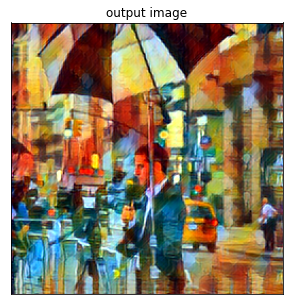

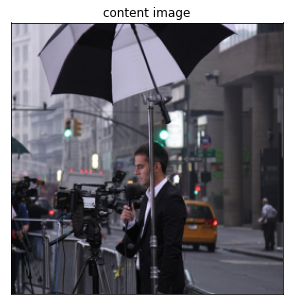

Epoch 0:	[32000/118287]	average content loss: 1127343.7971328124	average style loss: 586112.3538203125	total loss: 1713456.150953125


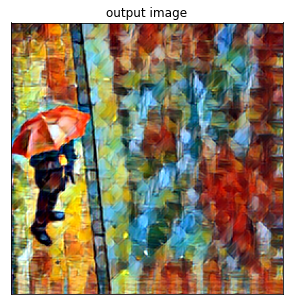

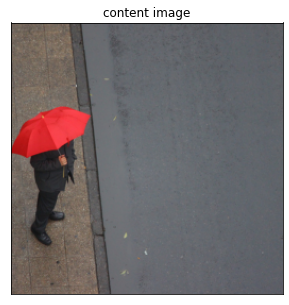

Epoch 0:	[34000/118287]	average content loss: 1117773.350242647	average style loss: 570931.2970514706	total loss: 1688704.6472941176


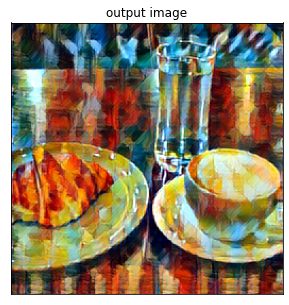

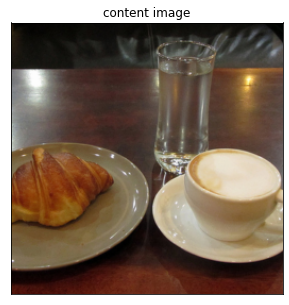

Epoch 0:	[36000/118287]	average content loss: 1108881.1886666666	average style loss: 557435.6159079861	total loss: 1666316.8045746528


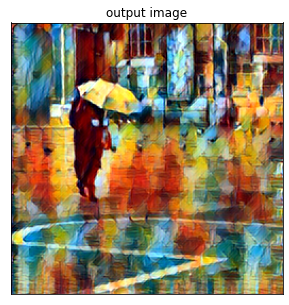

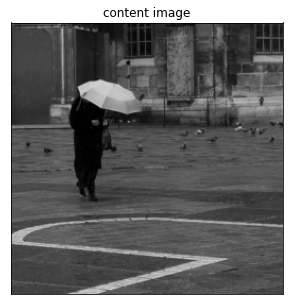

Epoch 0:	[38000/118287]	average content loss: 1100430.9018486843	average style loss: 545202.1784917763	total loss: 1645633.0803404606


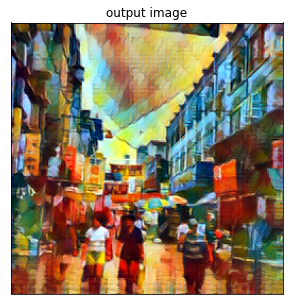

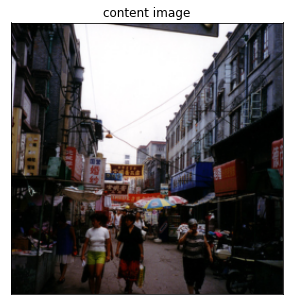

Epoch 0:	[40000/118287]	average content loss: 1092982.1309	average style loss: 534063.5466078125	total loss: 1627045.6775078124


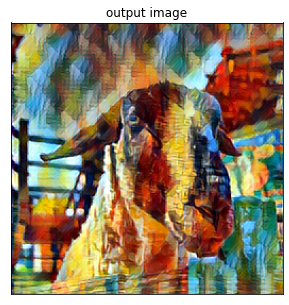

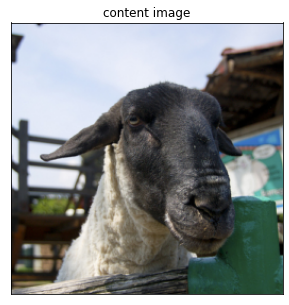

Epoch 0:	[42000/118287]	average content loss: 1085642.7893214286	average style loss: 523772.1996919643	total loss: 1609414.989013393


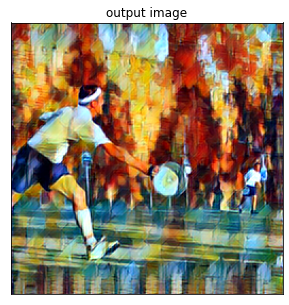

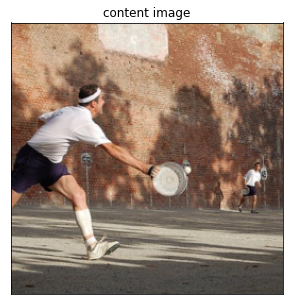

Epoch 0:	[44000/118287]	average content loss: 1078405.4869261363	average style loss: 514440.46916619316	total loss: 1592845.9560923295


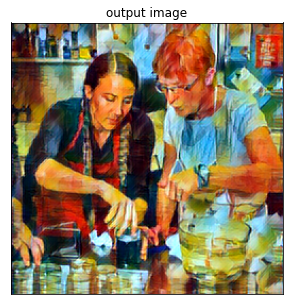

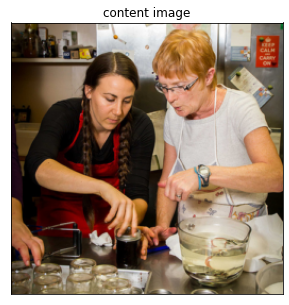

Epoch 0:	[46000/118287]	average content loss: 1071829.7420163043	average style loss: 505922.4688138587	total loss: 1577752.210830163


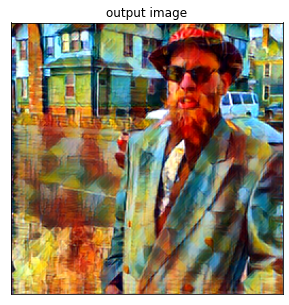

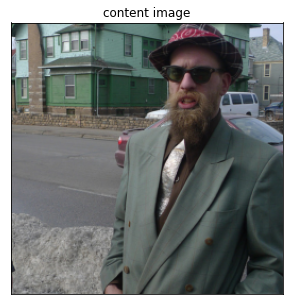

Epoch 0:	[48000/118287]	average content loss: 1065659.2186927083	average style loss: 498030.291125	total loss: 1563689.5098177083


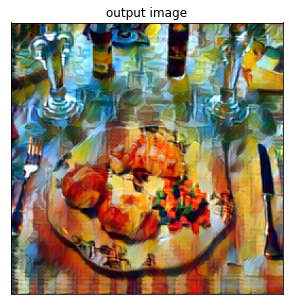

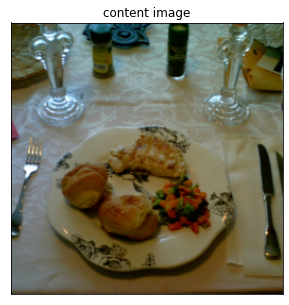

Epoch 0:	[50000/118287]	average content loss: 1059715.69403	average style loss: 490641.260385	total loss: 1550356.954415


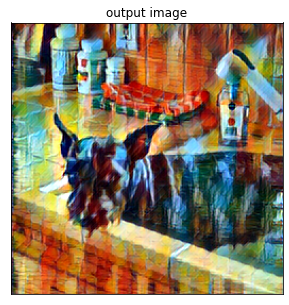

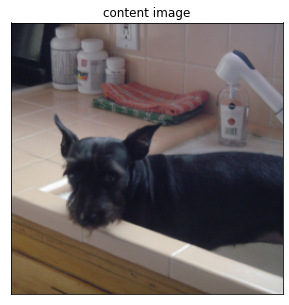

Epoch 0:	[52000/118287]	average content loss: 1054341.6249278847	average style loss: 483839.79728605767	total loss: 1538181.4222139423


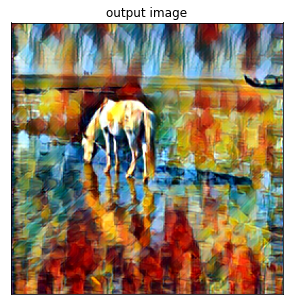

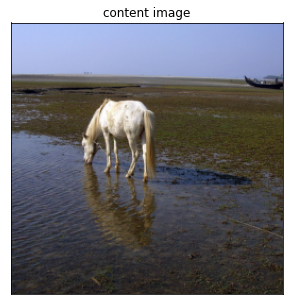

Epoch 0:	[54000/118287]	average content loss: 1049114.9674814814	average style loss: 477491.7100092593	total loss: 1526606.6774907408


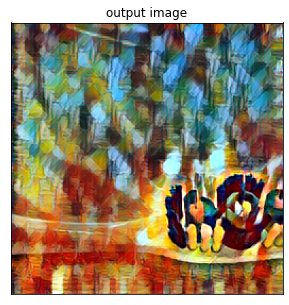

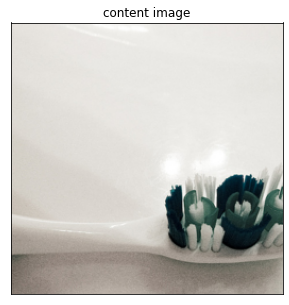

Epoch 0:	[56000/118287]	average content loss: 1044433.9774419643	average style loss: 471571.3744977678	total loss: 1516005.3519397322


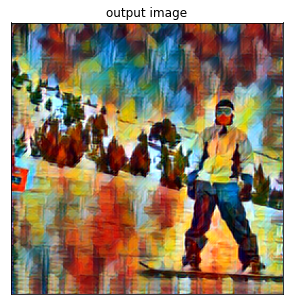

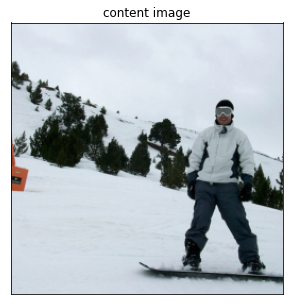

Epoch 0:	[58000/118287]	average content loss: 1039727.9724482759	average style loss: 465951.59455280175	total loss: 1505679.5670010776


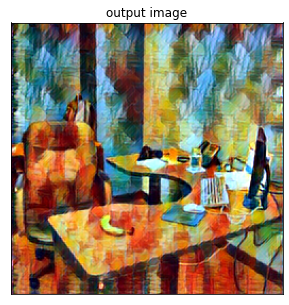

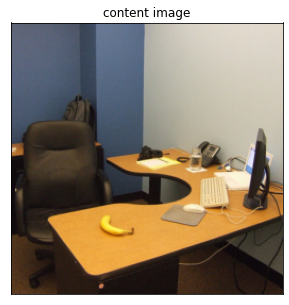

Epoch 0:	[60000/118287]	average content loss: 1035338.4563875	average style loss: 460633.57628958335	total loss: 1495972.0326770833


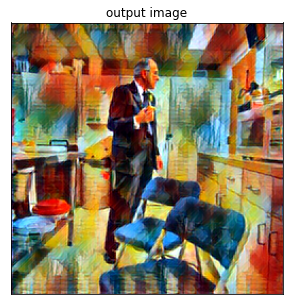

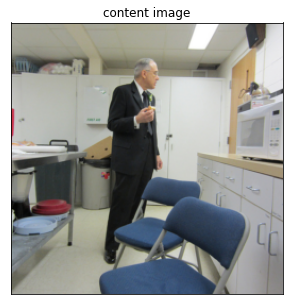

Epoch 0:	[62000/118287]	average content loss: 1030867.0811975807	average style loss: 455620.3109939516	total loss: 1486487.3921915323


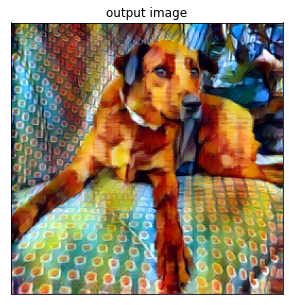

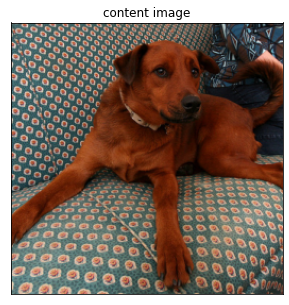

Epoch 0:	[64000/118287]	average content loss: 1026864.93728125	average style loss: 450866.60672753904	total loss: 1477731.5440087891


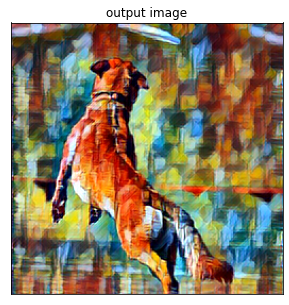

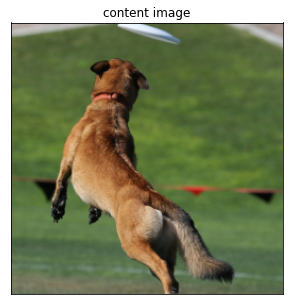

Epoch 0:	[66000/118287]	average content loss: 1023114.2206515152	average style loss: 446479.42023295455	total loss: 1469593.6408844697


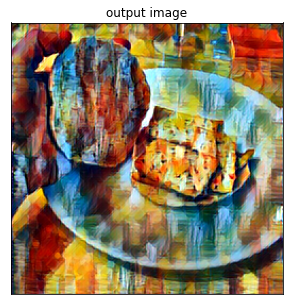

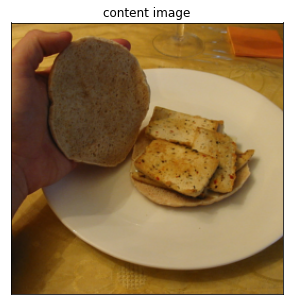

Epoch 0:	[68000/118287]	average content loss: 1019133.1021691177	average style loss: 442203.20656341914	total loss: 1461336.3087325369


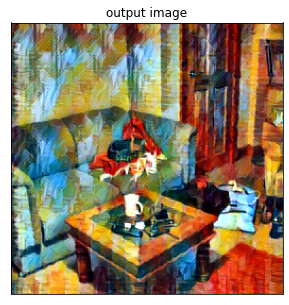

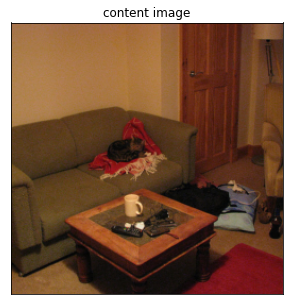

Epoch 0:	[70000/118287]	average content loss: 1015286.3791071429	average style loss: 438172.05316875	total loss: 1453458.432275893


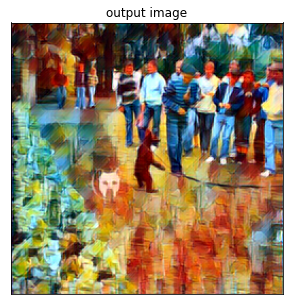

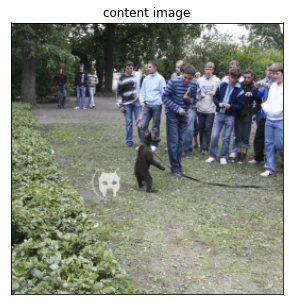

Epoch 0:	[72000/118287]	average content loss: 1011832.2256493055	average style loss: 434337.2540138889	total loss: 1446169.4796631944


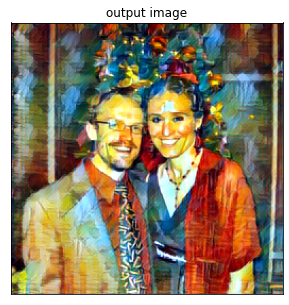

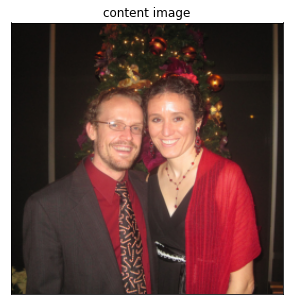

Epoch 0:	[74000/118287]	average content loss: 1008277.75575	average style loss: 430746.6748910473	total loss: 1439024.4306410472


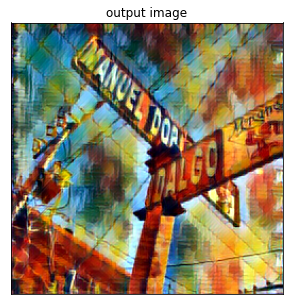

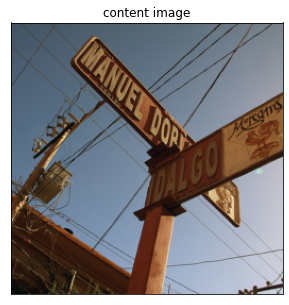

Epoch 0:	[76000/118287]	average content loss: 1005025.4535164473	average style loss: 427288.6315830592	total loss: 1432314.0850995067


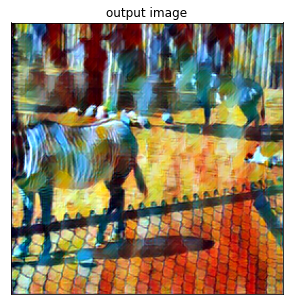

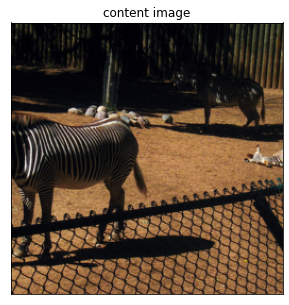

Epoch 0:	[78000/118287]	average content loss: 1001937.1853717949	average style loss: 423977.01147516025	total loss: 1425914.1968469552


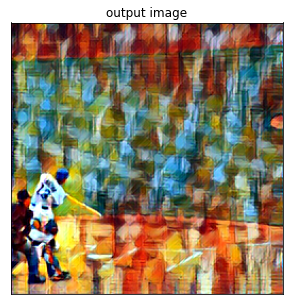

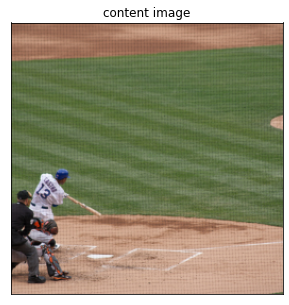

Epoch 0:	[80000/118287]	average content loss: 999013.2989375	average style loss: 420835.0615117187	total loss: 1419848.3604492187


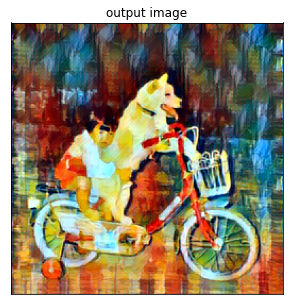

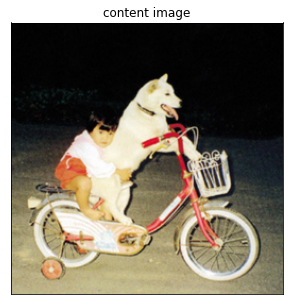

Epoch 0:	[82000/118287]	average content loss: 996245.0307408536	average style loss: 417797.0391714939	total loss: 1414042.0699123475


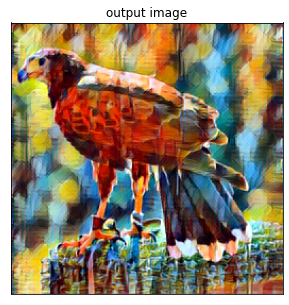

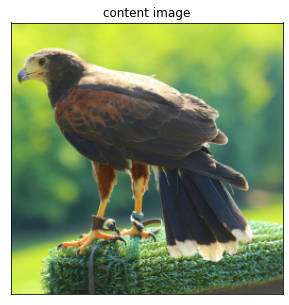

Epoch 0:	[84000/118287]	average content loss: 993461.4771339286	average style loss: 414822.99475297617	total loss: 1408284.4718869047


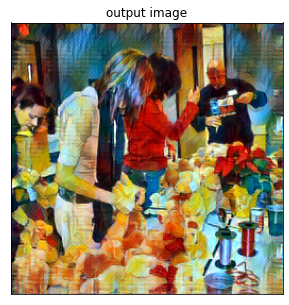

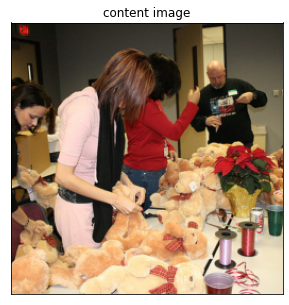

Epoch 0:	[86000/118287]	average content loss: 990805.3370959302	average style loss: 412038.43543968024	total loss: 1402843.7725356105


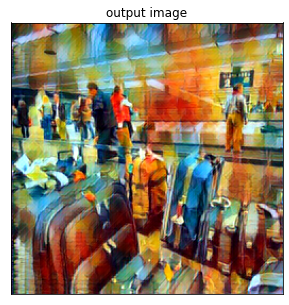

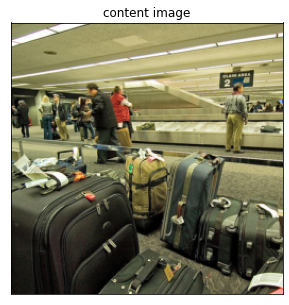

Epoch 0:	[88000/118287]	average content loss: 988154.1758011364	average style loss: 409370.26017329545	total loss: 1397524.435974432


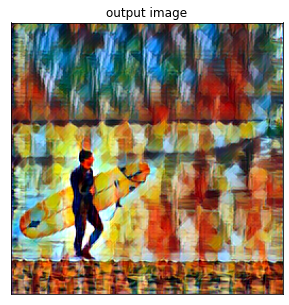

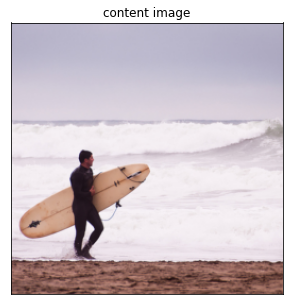

Epoch 0:	[90000/118287]	average content loss: 985621.9731888889	average style loss: 406825.10136458336	total loss: 1392447.0745534722


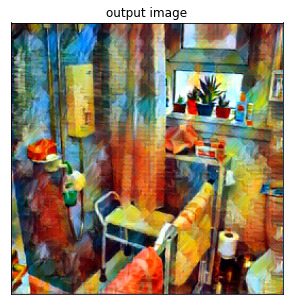

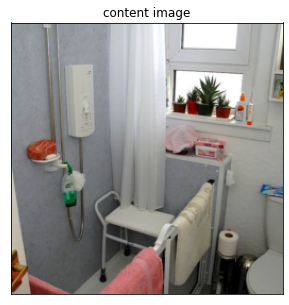

Epoch 0:	[92000/118287]	average content loss: 983209.6326766304	average style loss: 404346.4026929348	total loss: 1387556.0353695652


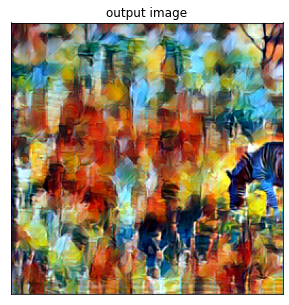

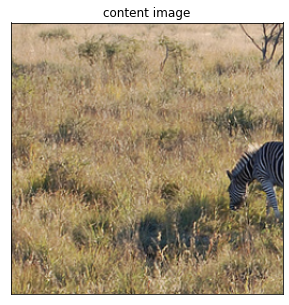

Epoch 0:	[94000/118287]	average content loss: 980781.0799654255	average style loss: 401981.60965625	total loss: 1382762.6896216755


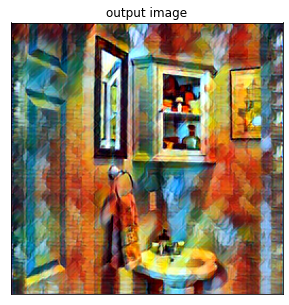

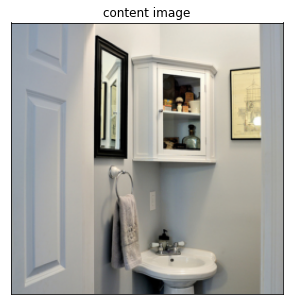

Epoch 0:	[96000/118287]	average content loss: 978497.64734375	average style loss: 399660.03375065106	total loss: 1378157.681094401


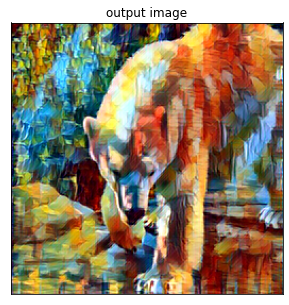

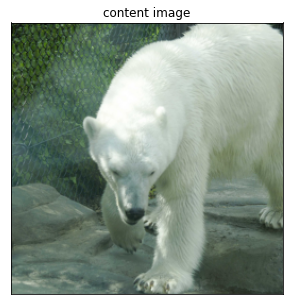

Epoch 0:	[98000/118287]	average content loss: 976309.4006836734	average style loss: 397432.75977614796	total loss: 1373742.1604598213


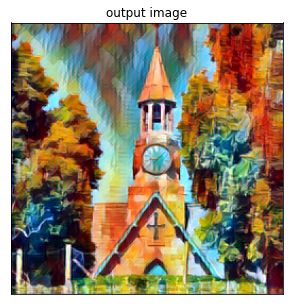

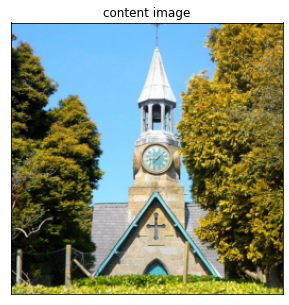

Epoch 0:	[100000/118287]	average content loss: 974123.6243975	average style loss: 395315.07803	total loss: 1369438.7024275


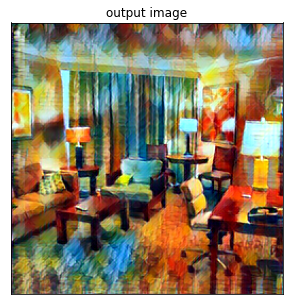

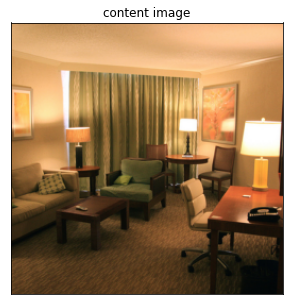

Epoch 0:	[102000/118287]	average content loss: 972025.1953161765	average style loss: 393232.21998835786	total loss: 1365257.4153045344


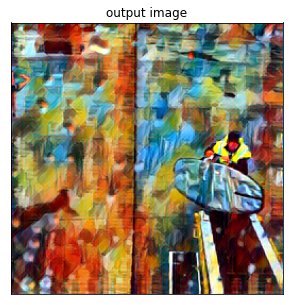

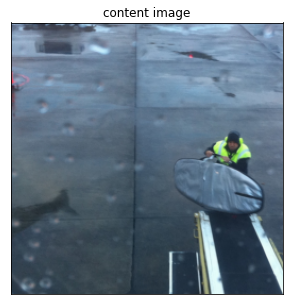

Epoch 0:	[104000/118287]	average content loss: 969909.4281971154	average style loss: 391256.9323894231	total loss: 1361166.3605865384


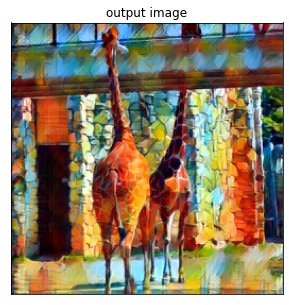

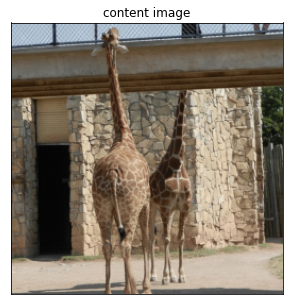

Epoch 0:	[106000/118287]	average content loss: 967823.5758160377	average style loss: 389322.524942217	total loss: 1357146.1007582548


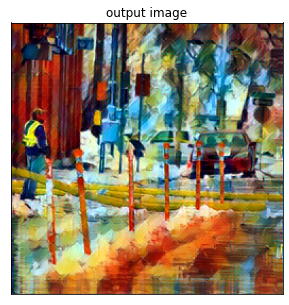

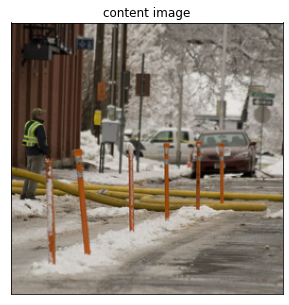

Epoch 0:	[108000/118287]	average content loss: 965870.9014375	average style loss: 387461.70188368054	total loss: 1353332.6033211804


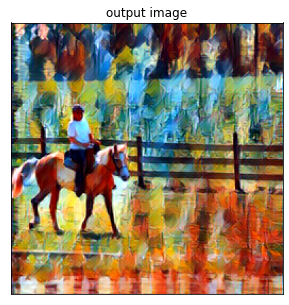

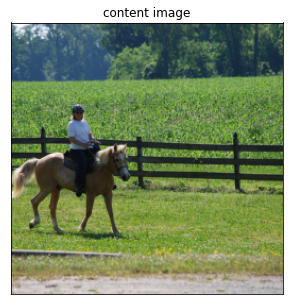

Epoch 0:	[110000/118287]	average content loss: 963962.7871545454	average style loss: 385661.2558744318	total loss: 1349624.0430289772


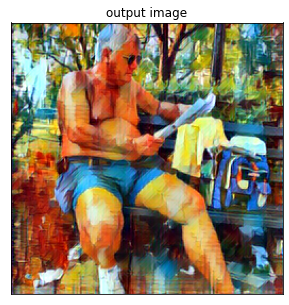

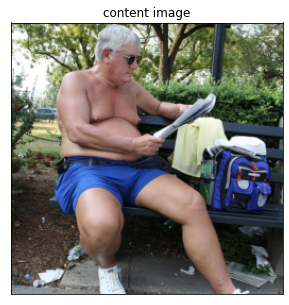

Epoch 0:	[112000/118287]	average content loss: 962151.2662053572	average style loss: 383878.16613671876	total loss: 1346029.432342076


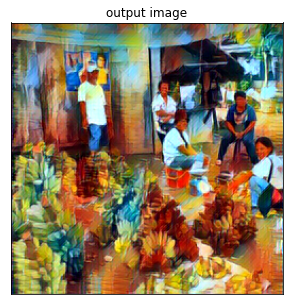

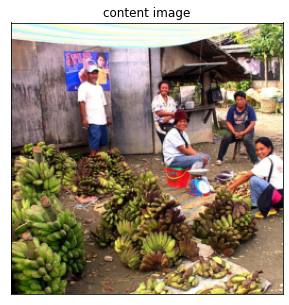

Epoch 0:	[114000/118287]	average content loss: 960356.3243421053	average style loss: 382142.1840849781	total loss: 1342498.5084270833


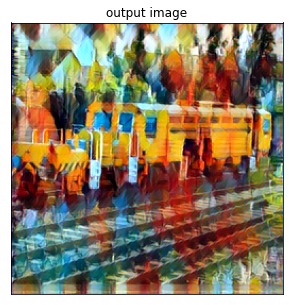

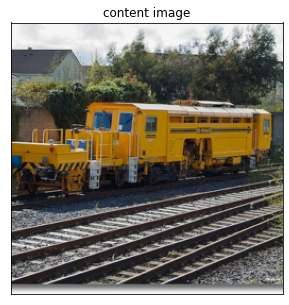

Epoch 0:	[116000/118287]	average content loss: 958637.4888987069	average style loss: 380546.31981842674	total loss: 1339183.8087171337


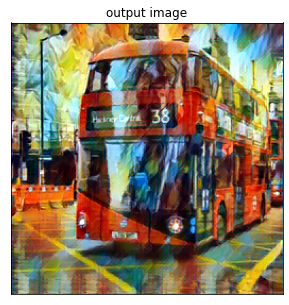

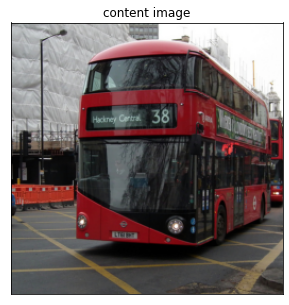

Epoch 0:	[118000/118287]	average content loss: 956945.108095339	average style loss: 378913.8124645127	total loss: 1335858.9205598517


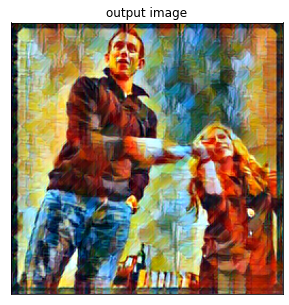

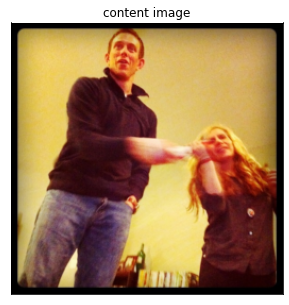

Epoch 1:	[2000/118287]	average content loss: 856932.720875	average style loss: 284623.200375	total loss: 1141555.92125


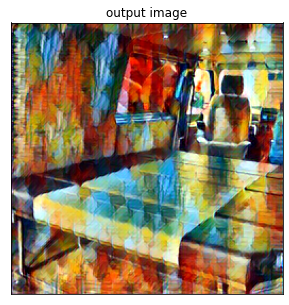

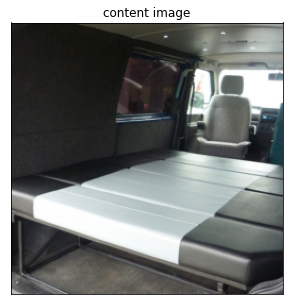

Epoch 1:	[4000/118287]	average content loss: 857312.722625	average style loss: 284530.378453125	total loss: 1141843.101078125


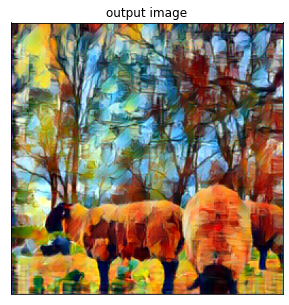

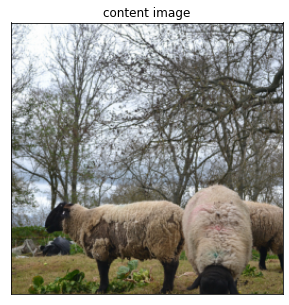

Epoch 1:	[6000/118287]	average content loss: 858028.9844583333	average style loss: 286947.46421875	total loss: 1144976.4486770832


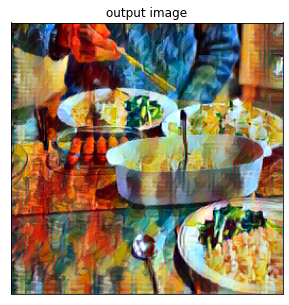

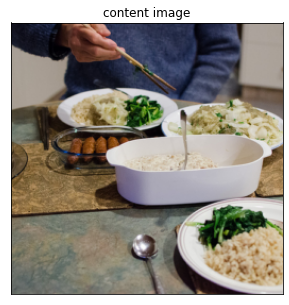

Epoch 1:	[8000/118287]	average content loss: 857547.77759375	average style loss: 286343.2326484375	total loss: 1143891.0102421874


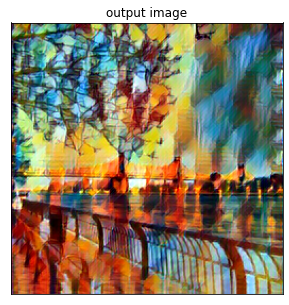

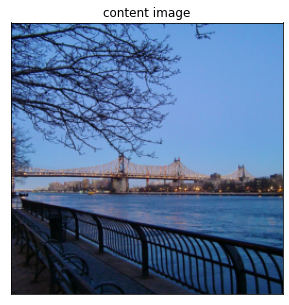

Epoch 1:	[10000/118287]	average content loss: 857860.61325	average style loss: 285948.8053	total loss: 1143809.41855


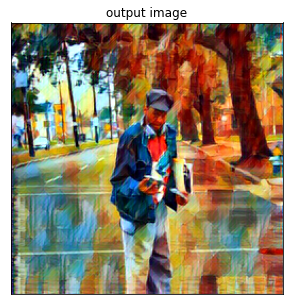

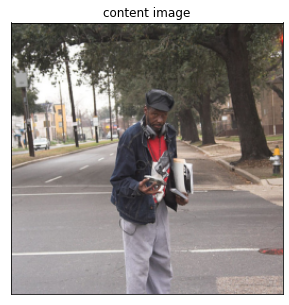

Epoch 1:	[12000/118287]	average content loss: 857204.9724791667	average style loss: 285471.88689583336	total loss: 1142676.859375


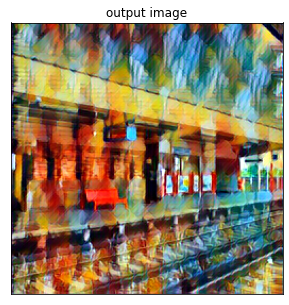

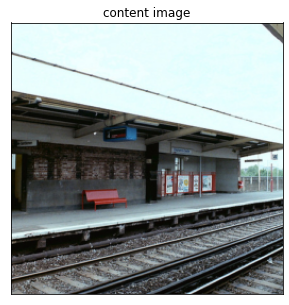

Epoch 1:	[14000/118287]	average content loss: 856389.8129821429	average style loss: 285108.99175	total loss: 1141498.804732143


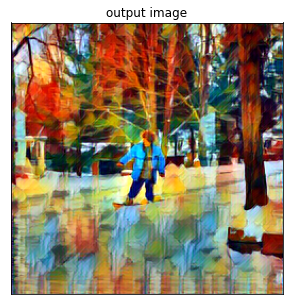

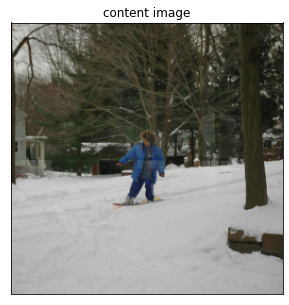

Epoch 1:	[16000/118287]	average content loss: 855878.19228125	average style loss: 284602.05978125	total loss: 1140480.2520625


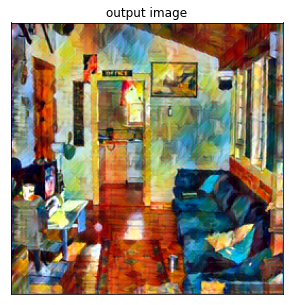

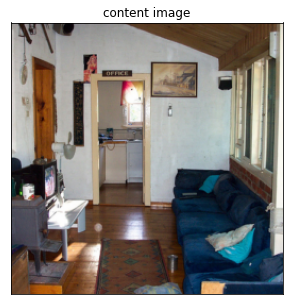

Epoch 1:	[18000/118287]	average content loss: 854981.0486944445	average style loss: 284162.2246736111	total loss: 1139143.2733680555


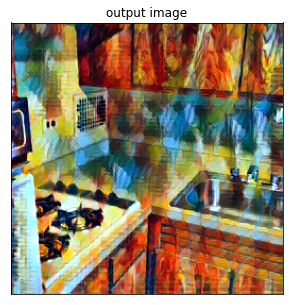

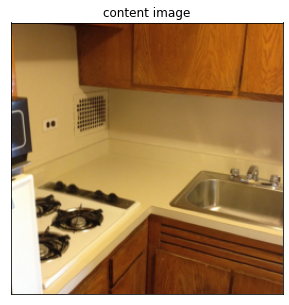

Epoch 1:	[20000/118287]	average content loss: 854671.7327125	average style loss: 284079.974925	total loss: 1138751.7076375


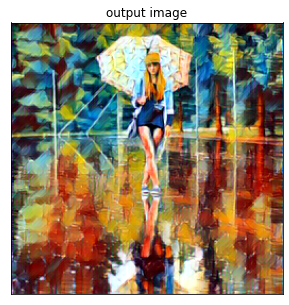

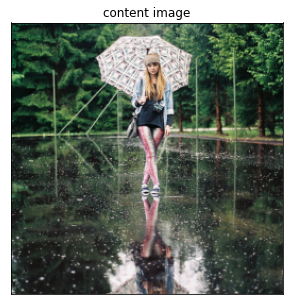

Epoch 1:	[22000/118287]	average content loss: 854092.074375	average style loss: 283821.62264772726	total loss: 1137913.6970227272


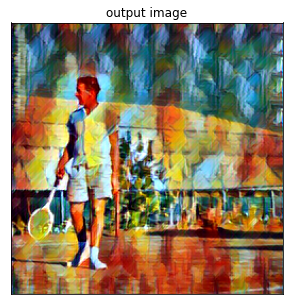

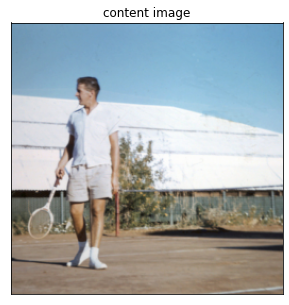

Epoch 1:	[24000/118287]	average content loss: 853636.781375	average style loss: 283719.83320833335	total loss: 1137356.6145833333


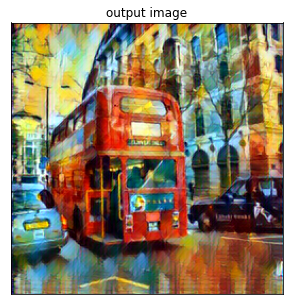

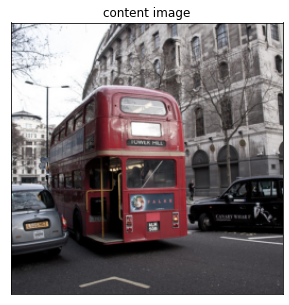

Epoch 1:	[26000/118287]	average content loss: 853480.1227692307	average style loss: 283379.56073076924	total loss: 1136859.6835


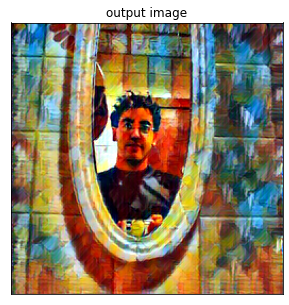

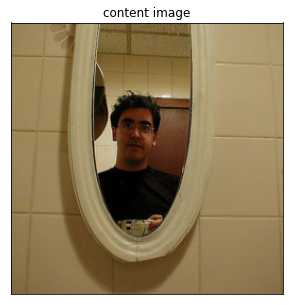

Epoch 1:	[28000/118287]	average content loss: 853136.4446071428	average style loss: 283142.4045982143	total loss: 1136278.8492053573


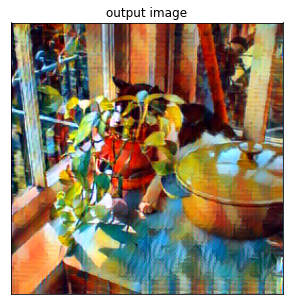

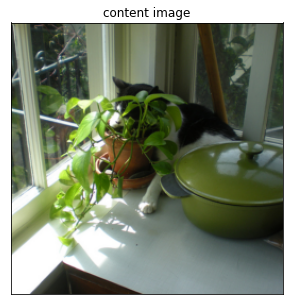

Epoch 1:	[30000/118287]	average content loss: 852673.6655166667	average style loss: 282863.43563958333	total loss: 1135537.10115625


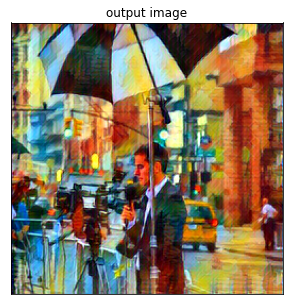

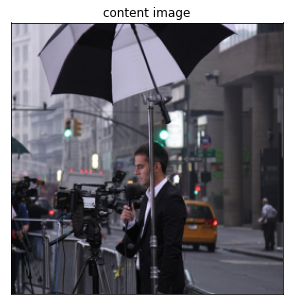

Epoch 1:	[32000/118287]	average content loss: 852227.431390625	average style loss: 282696.2864335938	total loss: 1134923.7178242188


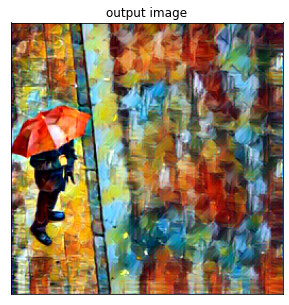

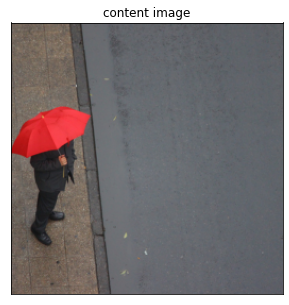

Epoch 1:	[34000/118287]	average content loss: 851860.5150294118	average style loss: 282469.36115808826	total loss: 1134329.8761875


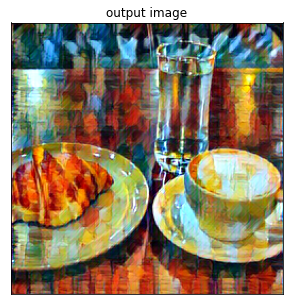

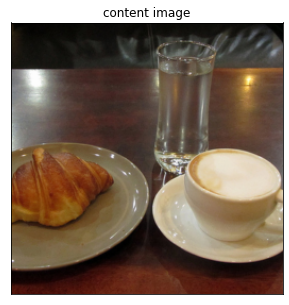

Epoch 1:	[36000/118287]	average content loss: 851516.5854097222	average style loss: 282314.4280416667	total loss: 1133831.0134513888


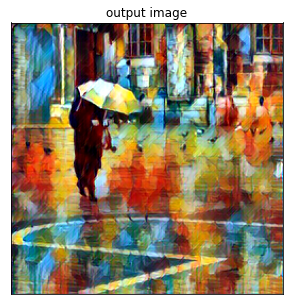

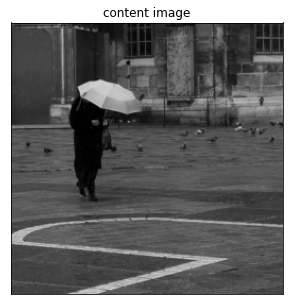

Epoch 1:	[38000/118287]	average content loss: 850964.7859342105	average style loss: 282119.34250328946	total loss: 1133084.1284375


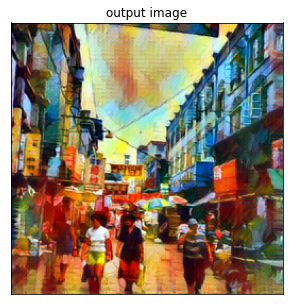

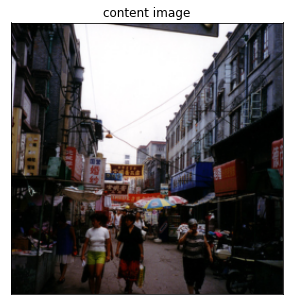

Epoch 1:	[40000/118287]	average content loss: 850950.82089375	average style loss: 281917.61955625	total loss: 1132868.44045


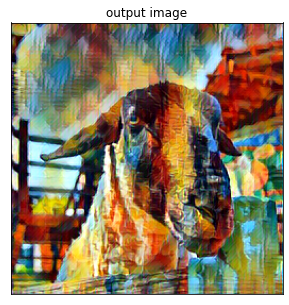

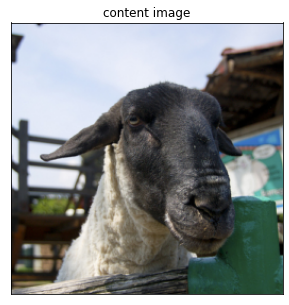

Epoch 1:	[42000/118287]	average content loss: 850615.9696666667	average style loss: 281637.0092633928	total loss: 1132252.9789300596


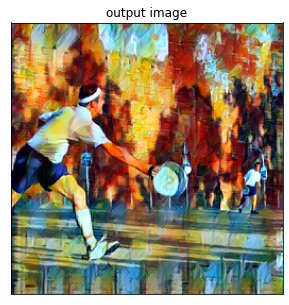

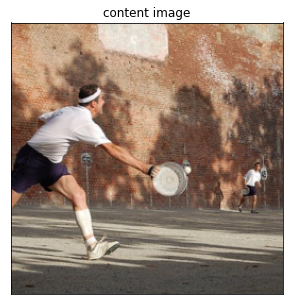

Epoch 1:	[44000/118287]	average content loss: 849891.1478295454	average style loss: 281373.93077982956	total loss: 1131265.078609375


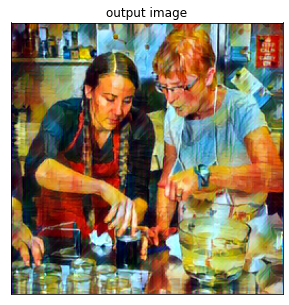

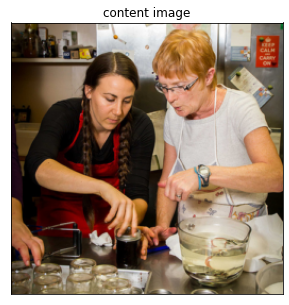

Epoch 1:	[46000/118287]	average content loss: 849405.2079891304	average style loss: 281201.2190896739	total loss: 1130606.4270788042


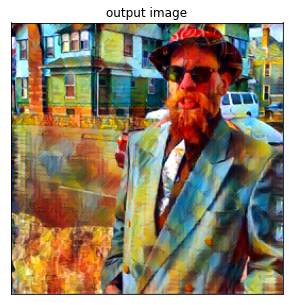

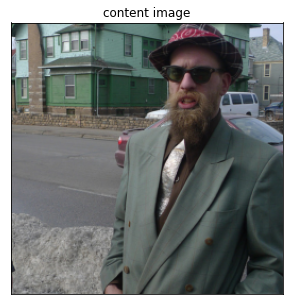

Epoch 1:	[48000/118287]	average content loss: 849060.6805729166	average style loss: 281034.07771875	total loss: 1130094.7582916666


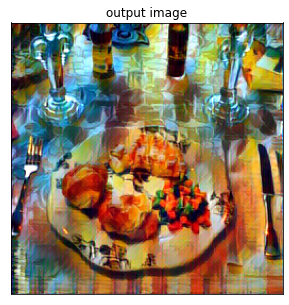

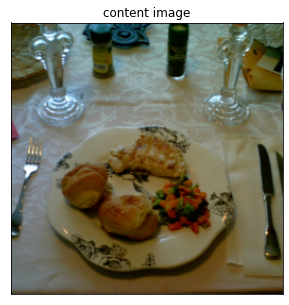

Epoch 1:	[50000/118287]	average content loss: 848578.699765	average style loss: 280827.11134	total loss: 1129405.811105


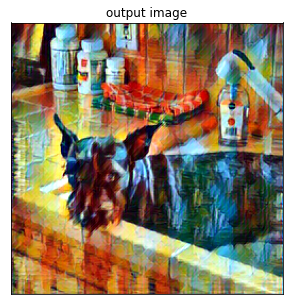

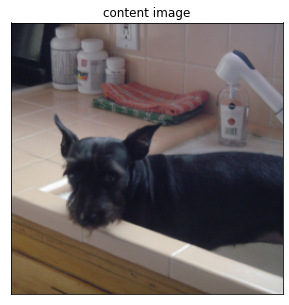

Epoch 1:	[52000/118287]	average content loss: 848385.5848846154	average style loss: 280694.97934375	total loss: 1129080.5642283654


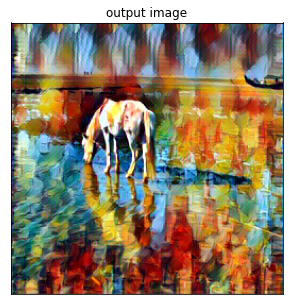

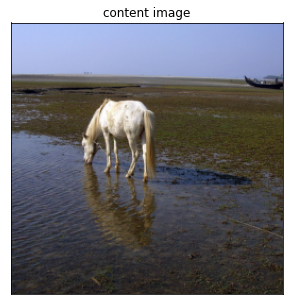

Epoch 1:	[54000/118287]	average content loss: 847997.4770833333	average style loss: 280550.9842951389	total loss: 1128548.4613784722


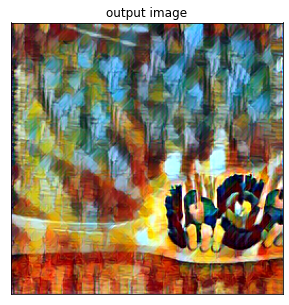

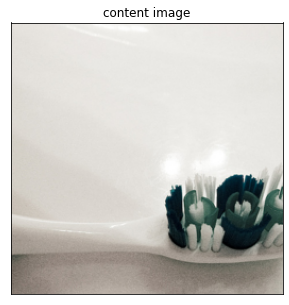

Epoch 1:	[56000/118287]	average content loss: 847950.3386473214	average style loss: 280398.03266741073	total loss: 1128348.3713147321


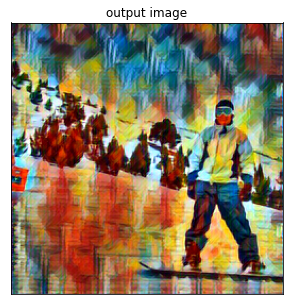

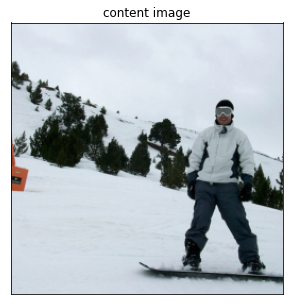

Epoch 1:	[58000/118287]	average content loss: 847665.5534827586	average style loss: 280254.51563038793	total loss: 1127920.0691131465


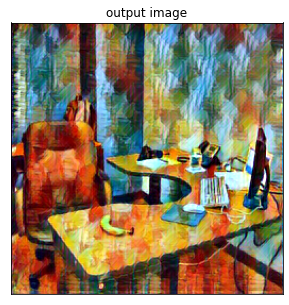

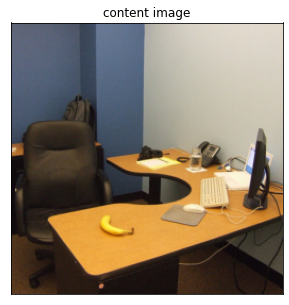

Epoch 1:	[60000/118287]	average content loss: 847483.5815958333	average style loss: 280082.62821145833	total loss: 1127566.2098072916


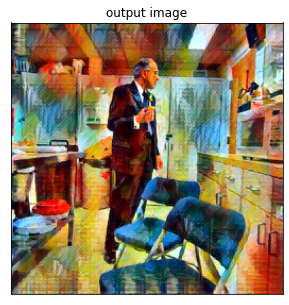

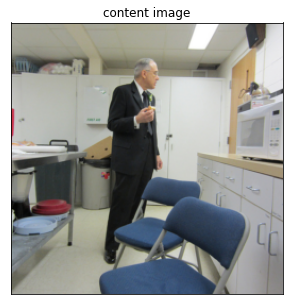

Epoch 1:	[62000/118287]	average content loss: 846985.5730362904	average style loss: 279901.2432268145	total loss: 1126886.8162631048


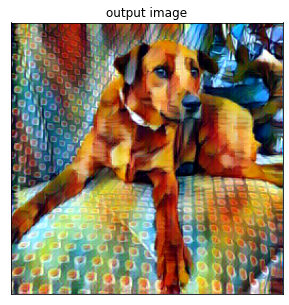

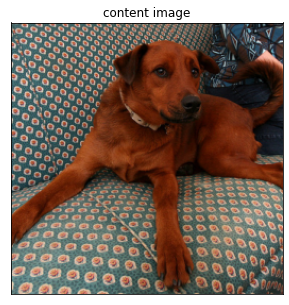

Epoch 1:	[64000/118287]	average content loss: 846799.99615625	average style loss: 279701.6020957031	total loss: 1126501.598251953


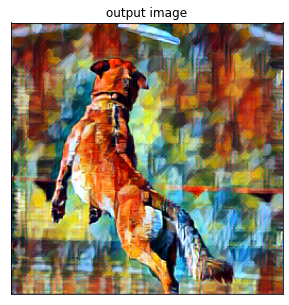

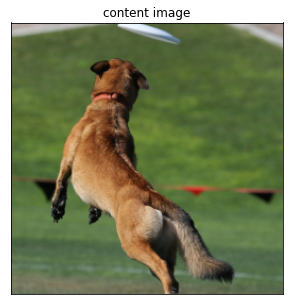

Epoch 1:	[66000/118287]	average content loss: 846645.938655303	average style loss: 279562.0083001894	total loss: 1126207.9469554925


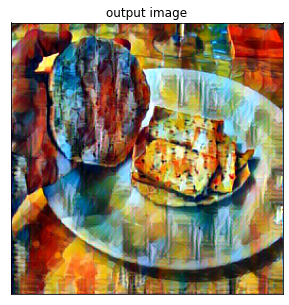

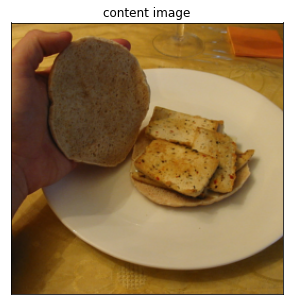

Epoch 1:	[68000/118287]	average content loss: 846118.2852794118	average style loss: 279356.18916452205	total loss: 1125474.474443934


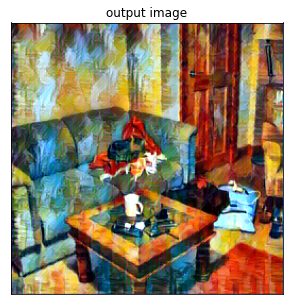

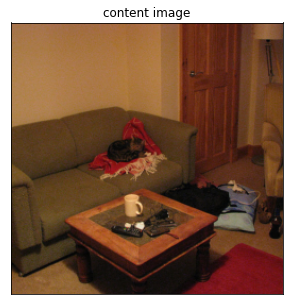

Epoch 1:	[70000/118287]	average content loss: 845586.9539107142	average style loss: 279181.64136696426	total loss: 1124768.5952776787


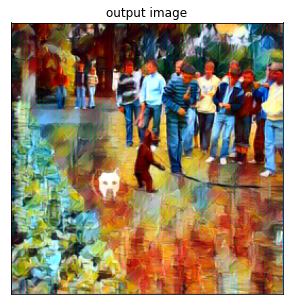

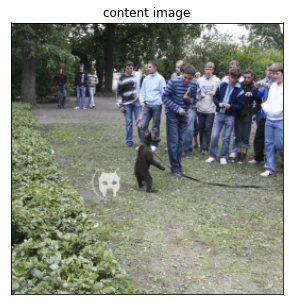

Epoch 1:	[72000/118287]	average content loss: 845327.4025590278	average style loss: 279007.3123741319	total loss: 1124334.7149331598


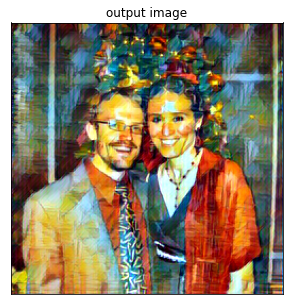

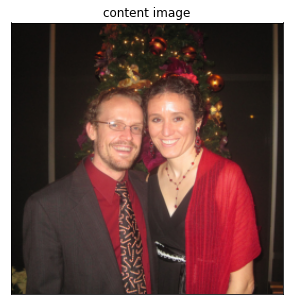

Epoch 1:	[74000/118287]	average content loss: 844813.3231858108	average style loss: 278865.38938597974	total loss: 1123678.7125717904


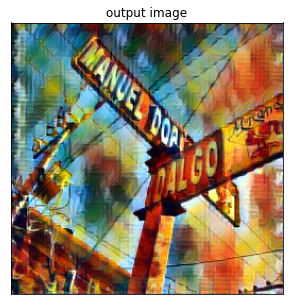

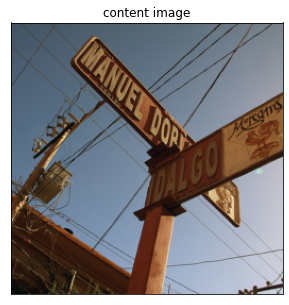

Epoch 1:	[76000/118287]	average content loss: 844495.8241546053	average style loss: 278726.35471463815	total loss: 1123222.1788692435


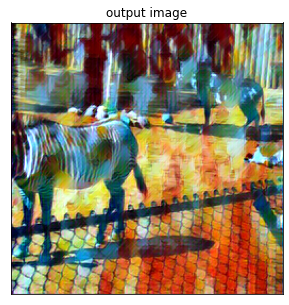

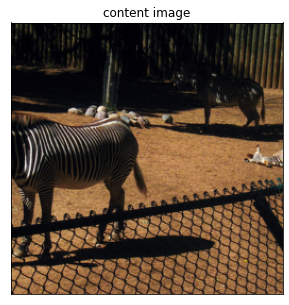

Epoch 1:	[78000/118287]	average content loss: 844238.0589070513	average style loss: 278580.99969310896	total loss: 1122819.0586001603


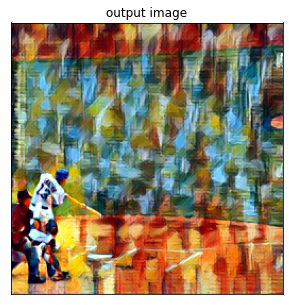

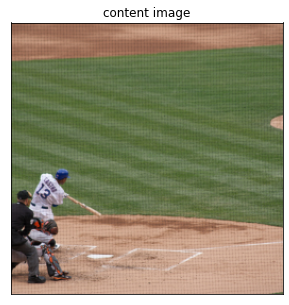

Epoch 1:	[80000/118287]	average content loss: 844023.0951	average style loss: 278461.76137734373	total loss: 1122484.8564773437


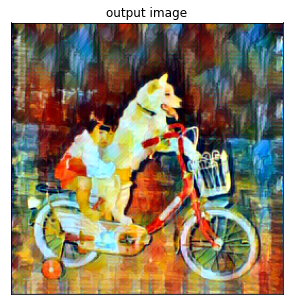

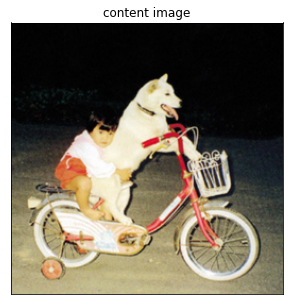

Epoch 1:	[82000/118287]	average content loss: 843884.9776554878	average style loss: 278306.2364321646	total loss: 1122191.2140876525


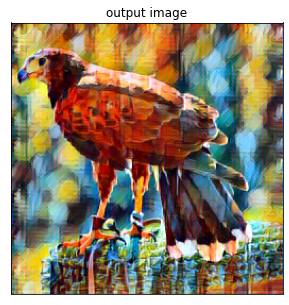

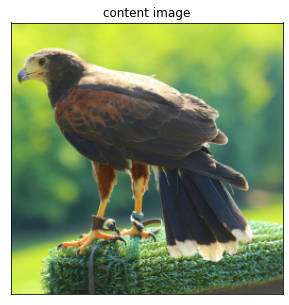

Epoch 1:	[84000/118287]	average content loss: 843637.7395833334	average style loss: 278120.3345855655	total loss: 1121758.0741688989


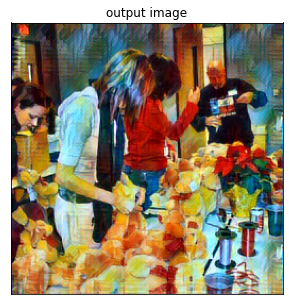

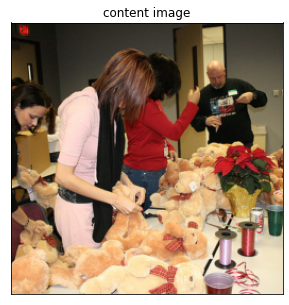

Epoch 1:	[86000/118287]	average content loss: 843421.3721075582	average style loss: 277997.5434026163	total loss: 1121418.9155101744


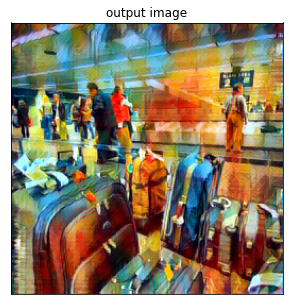

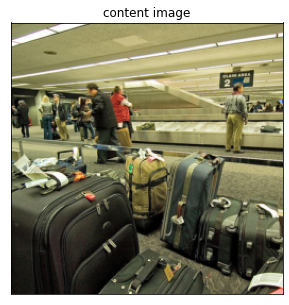

Epoch 1:	[88000/118287]	average content loss: 843114.7404034091	average style loss: 277849.781453125	total loss: 1120964.521856534


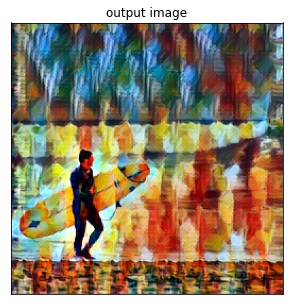

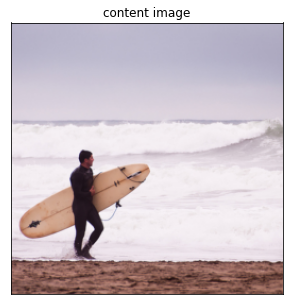

Epoch 1:	[90000/118287]	average content loss: 842813.6484444444	average style loss: 277702.2613847222	total loss: 1120515.9098291667


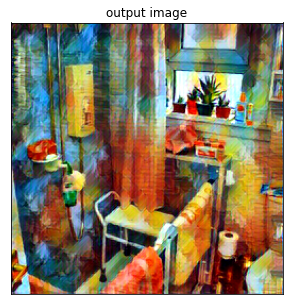

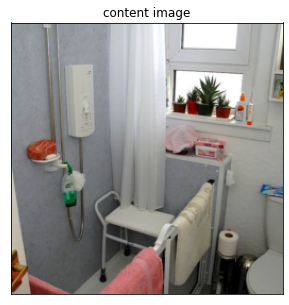

Epoch 1:	[92000/118287]	average content loss: 842592.621625	average style loss: 277558.4598451087	total loss: 1120151.0814701086


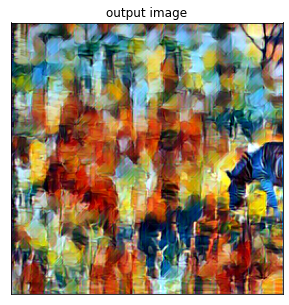

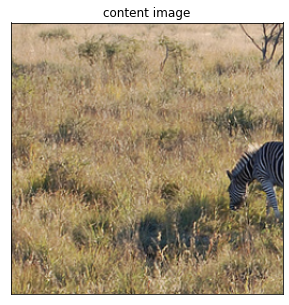

Epoch 1:	[94000/118287]	average content loss: 842279.5018776596	average style loss: 277428.1095425532	total loss: 1119707.6114202128


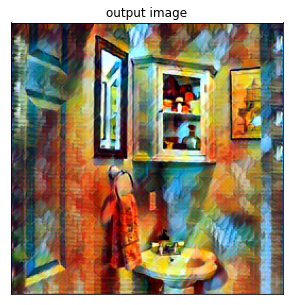

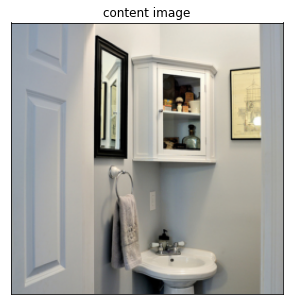

Epoch 1:	[96000/118287]	average content loss: 842054.3114739583	average style loss: 277280.4096901042	total loss: 1119334.7211640624


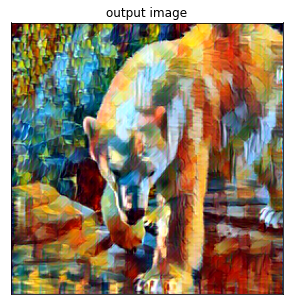

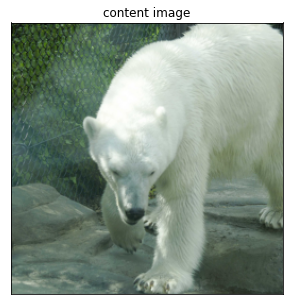

Epoch 1:	[98000/118287]	average content loss: 841867.0162627551	average style loss: 277115.92029081634	total loss: 1118982.9365535714


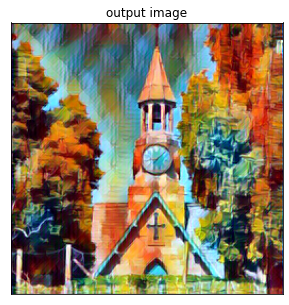

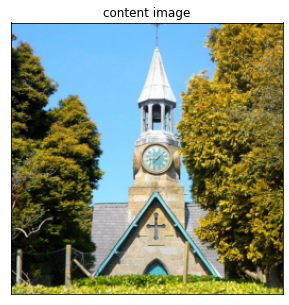

Epoch 1:	[100000/118287]	average content loss: 841603.7013825	average style loss: 277018.1270225	total loss: 1118621.828405


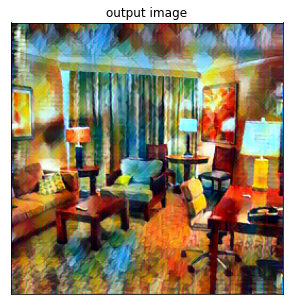

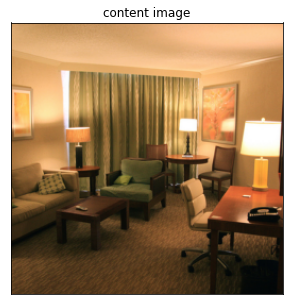

Epoch 1:	[102000/118287]	average content loss: 841381.091117647	average style loss: 276882.0286930147	total loss: 1118263.1198106618


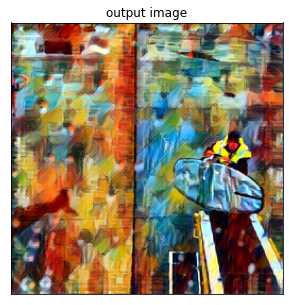

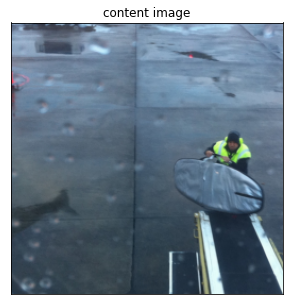

Epoch 1:	[104000/118287]	average content loss: 841069.2410288461	average style loss: 276788.12079987983	total loss: 1117857.361828726


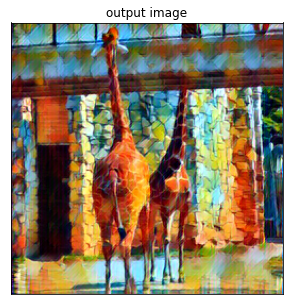

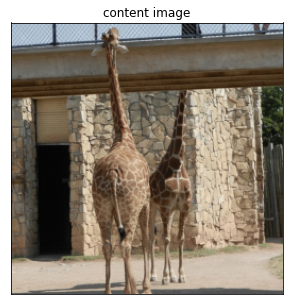

Epoch 1:	[106000/118287]	average content loss: 840732.8163136792	average style loss: 276654.524870283	total loss: 1117387.3411839623


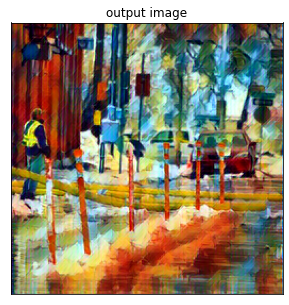

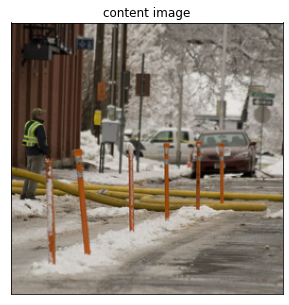

Epoch 1:	[108000/118287]	average content loss: 840486.1243587963	average style loss: 276534.7442042824	total loss: 1117020.8685630788


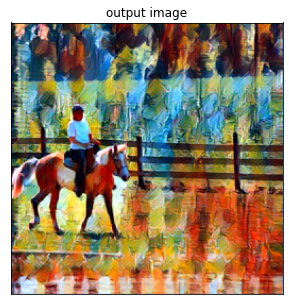

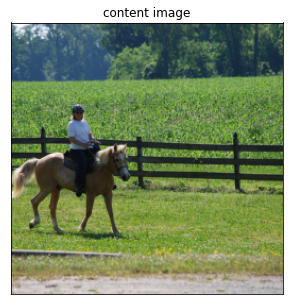

Epoch 1:	[110000/118287]	average content loss: 840230.1787204546	average style loss: 276409.6714346591	total loss: 1116639.8501551137


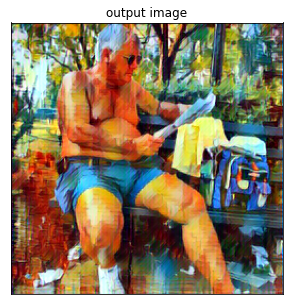

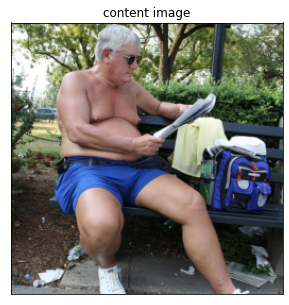

Epoch 1:	[112000/118287]	average content loss: 840033.0369107142	average style loss: 276284.77445033484	total loss: 1116317.811361049


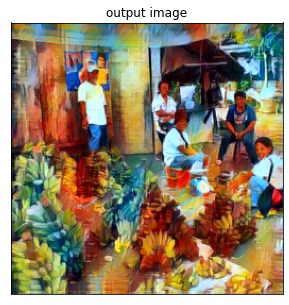

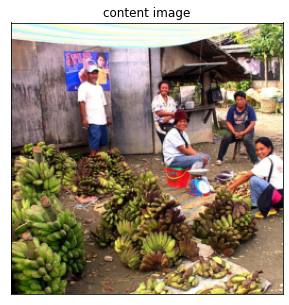

Epoch 1:	[114000/118287]	average content loss: 839805.8494364035	average style loss: 276135.38934210525	total loss: 1115941.2387785087


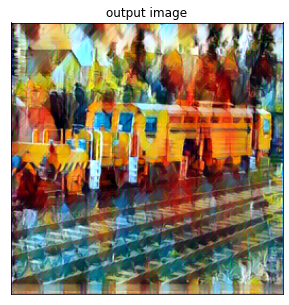

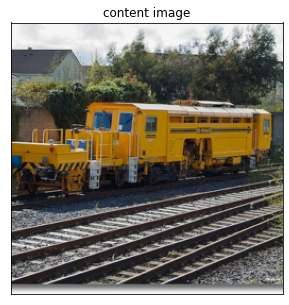

Epoch 1:	[116000/118287]	average content loss: 839608.6056724138	average style loss: 276060.2258065733	total loss: 1115668.8314789871


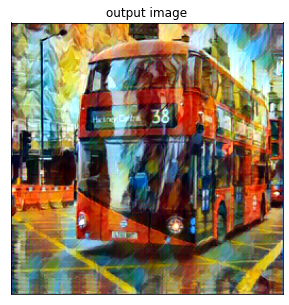

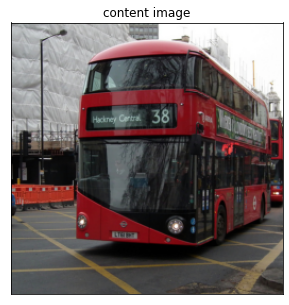

Epoch 1:	[118000/118287]	average content loss: 839398.9814491526	average style loss: 275921.8811382415	total loss: 1115320.862587394


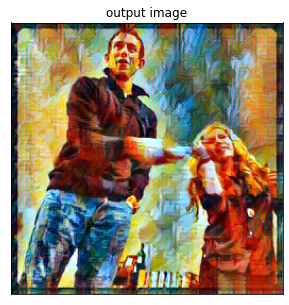

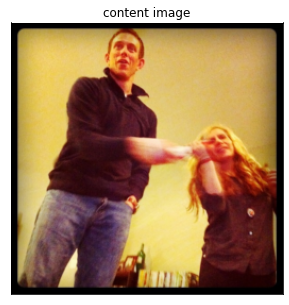

[2000, 4000, 6000, 8000, 10000, 12000, 14000, 16000, 18000, 20000, 22000, 24000, 26000, 28000, 30000, 32000, 34000, 36000, 38000, 40000, 42000, 44000, 46000, 48000, 50000, 52000, 54000, 56000, 58000, 60000, 62000, 64000, 66000, 68000, 70000, 72000, 74000, 76000, 78000, 80000, 82000, 84000, 86000, 88000, 90000, 92000, 94000, 96000, 98000, 100000, 102000, 104000, 106000, 108000, 110000, 112000, 114000, 116000, 118000, 120287, 122287, 124287, 126287, 128287, 130287, 132287, 134287, 136287, 138287, 140287, 142287, 144287, 146287, 148287, 150287, 152287, 154287, 156287, 158287, 160287, 162287, 164287, 166287, 168287, 170287, 172287, 174287, 176287, 178287, 180287, 182287, 184287, 186287, 188287, 190287, 192287, 194287, 196287, 198287, 200287, 202287, 204287, 206287, 208287, 210287, 212287, 214287, 216287, 218287, 220287, 222287, 224287, 226287, 228287, 230287, 232287, 234287, 236287]


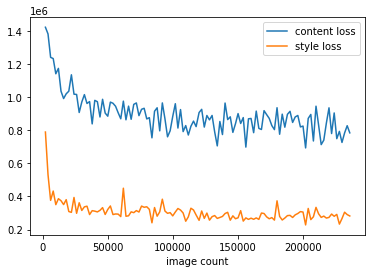

In [26]:
train()